In [8]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import torch
import os.path 

In [5]:
import sys
d2_net_path = "/home/mikhail/research/d2-net/lib"
d2_net_path_lib = "/home/mikhail/research/d2-net"
if d2_net_path not in sys.path:
    sys.path.append(d2_net_path)
if d2_net_path_lib not in sys.path:
    sys.path.append(d2_net_path_lib)
from pyramid import process_multiscale
from model_test import D2Net
from utils import preprocess_image

# Make D2 model

In [6]:
MODEL_FILE = "/home/mikhail/research/d2-net/models/d2_ots.pth"
DATASET_PATH = "data/7scenes/fire"
ROOT_PATH = "/home/mikhail/research/unsup-3d-keypoints"

In [7]:
MODEL = D2Net(
    model_file=MODEL_FILE,
    use_relu=True,
    use_cuda=True
)

# Load image

In [20]:
IMAGE_PATH = "/home/mikhail/research/lie-pose-net/data/7scenes/fire/seq-01/frame-000001.color.png"

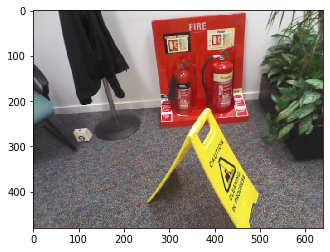

In [21]:
INPUT_IMAGE = np.asarray(Image.open(IMAGE_PATH))
plt.imshow(INPUT_IMAGE)

In [22]:
IMAGE_TENSOR = preprocess_image(INPUT_IMAGE, preprocessing="torch")[None]
IMAGE_TENSOR = torch.tensor(IMAGE_TENSOR).float().cuda()
IMAGE_TENSOR.size()

torch.Size([1, 3, 480, 640])

In [23]:
with torch.no_grad():
    keypoints, scores, descriptors = process_multiscale(IMAGE_TENSOR, MODEL, scales=[1])

/pytorch/torch/csrc/utils/python_arg_parser.cpp:756: UserWarning: This overload of nonzero is deprecated:
	nonzero(Tensor input, *, Tensor out)
Consider using one of the following signatures instead:
	nonzero(Tensor input, *, bool as_tuple)


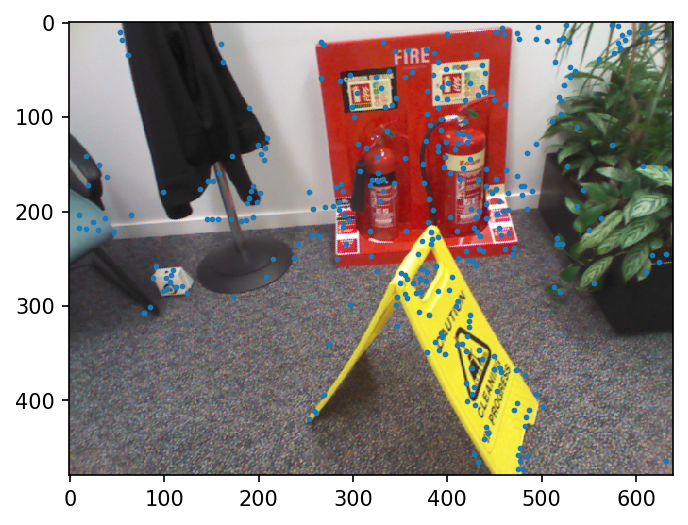

In [24]:
plt.figure(dpi=150)
plt.imshow(INPUT_IMAGE)
mask = scores > 15
plt.scatter(keypoints[mask, 1], keypoints[mask, 0], s=3)

## from sklearn.decomposition import PCA

In [25]:
from sklearn.decomposition import PCA

In [26]:
pca = PCA(n_components=3).fit(descriptors)
pca_descriptors = pca.transform(descriptors[mask])
len(pca_descriptors)

343

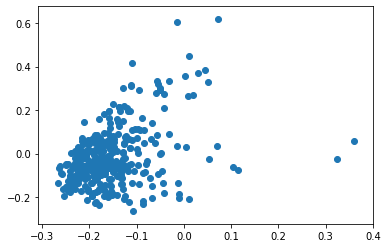

In [27]:
plt.scatter(pca_descriptors[:, 0], pca_descriptors[:, 1])

In [28]:
max_c = np.max(pca_descriptors)
min_c = np.min(pca_descriptors)
colors = np.clip((pca_descriptors - min_c) / (max_c - min_c), 0, 1)

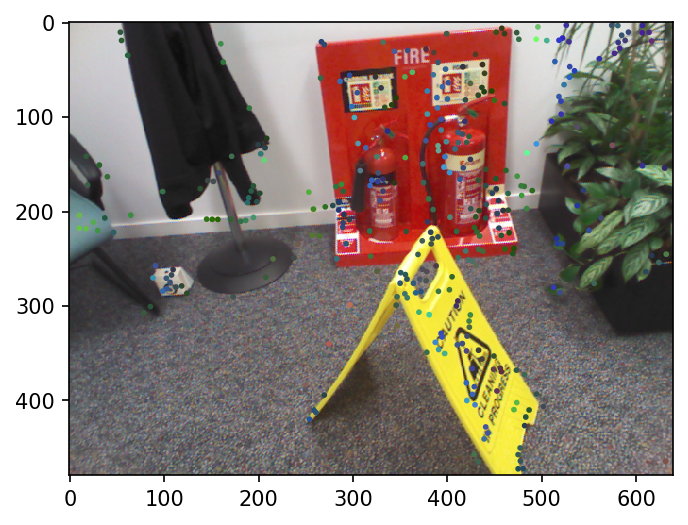

In [29]:
plt.figure(dpi=150)
plt.imshow(INPUT_IMAGE)
plt.scatter(keypoints[mask, 1], keypoints[mask, 0], s=3, c=colors)

In [30]:
def get_keypoints(model, image_path, min_score=None):
    image = np.asarray(Image.open(image_path))
    image_tensor = preprocess_image(image, preprocessing="torch")[None]
    image_tensor = torch.tensor(image_tensor).float().cuda()
    with torch.no_grad():
        keypoints, scores, descriptors = process_multiscale(image_tensor, model, scales=[1])
    if min_score is not None:
        mask = scores > min_score
        keypoints = keypoints[mask]
        descriptors = descriptors[mask]
    return keypoints.copy(), descriptors.copy()

# Matching

In [31]:
import cv2

In [32]:
from kapture_localization.matching.matching import MatchPairNnTorch

In [33]:
IMAGE_PATH1 = "/home/mikhail/research/lie-pose-net/data/7scenes/fire/seq-01/frame-000001.color.png"
IMAGE_PATH2 = "/home/mikhail/research/lie-pose-net/data/7scenes/fire/seq-01/frame-000030.color.png"
INPUT_IMAGE1 = np.asarray(Image.open(IMAGE_PATH1))
INPUT_IMAGE2 = np.asarray(Image.open(IMAGE_PATH2))

In [34]:
keypoints1, descriptors1 = get_keypoints(MODEL, IMAGE_PATH1, 15)
keypoints2, descriptors2 = get_keypoints(MODEL, IMAGE_PATH2, 15)

In [35]:
MATCHER = MatchPairNnTorch()

In [36]:
matches = MATCHER.match_descriptors(descriptors1, descriptors2)

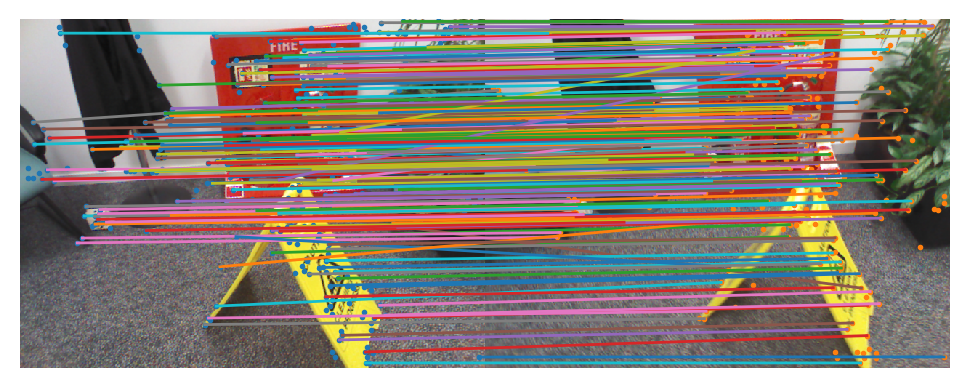

In [37]:
plt.figure(dpi=200)
output_image = np.concatenate([INPUT_IMAGE1, INPUT_IMAGE2], axis=1)

plt.imshow(output_image)
plt.scatter(keypoints1[:, 1], keypoints1[:, 0], s=1)
plt.scatter(keypoints2[:, 1] + 640, keypoints2[:, 0], s=1)
for match in matches:
    plt.plot([keypoints1[int(match[0]), 1], keypoints2[int(match[1]), 1] + 640], 
             [keypoints1[int(match[0]), 0], keypoints2[int(match[1]), 0]], linewidth=1)
plt.axis('off');

# Kapture keypoints

In [61]:
import kapture.io.csv as csv
from kapture.io.features import *
from kapture.io.csv import *
from kapture.io.records import *
import kapture
import os.path
from tqdm.notebook import tqdm as tqdm

KAPTURE_PATH = "/home/mikhail/research/unsup-3d-keypoints/data/kapture/7scenes/fire/mapping"
DATA_PATH = "/home/mikhail/research/unsup-3d-keypoints/data/kapture/7scenes/fire/mapping/sensors/records_data"
KAPTURE_DATA = csv.kapture_from_dir(KAPTURE_PATH)
MINIMAL_SCORE = 0
MINIMAL_MATCHING_SCORE = 0

In [62]:
KAPTURE_DATA.keypoints = kapture.Keypoints('d2net', keypoints.dtype, keypoints.shape[1])
KAPTURE_DATA.descriptors = kapture.Descriptors('d2net', descriptors.dtype, descriptors.shape[1])

keypoints_config_absolute_path = get_csv_fullpath(kapture.Keypoints, KAPTURE_PATH)
descriptors_config_absolute_path = get_csv_fullpath(kapture.Descriptors, KAPTURE_PATH)

keypoints_to_file(keypoints_config_absolute_path, KAPTURE_DATA.keypoints)
descriptors_to_file(descriptors_config_absolute_path, KAPTURE_DATA.descriptors)

In [63]:
image_list = [filename for _, _, filename in kapture.flatten(KAPTURE_DATA.records_camera)][:10]

In [65]:
for i, image_name in tqdm(enumerate(image_list)):
    image_path = get_image_fullpath(KAPTURE_PATH, image_name)
    keypoints, descriptors = get_keypoints(MODEL, image_path)
    keypoints_fullpath = get_keypoints_fullpath(KAPTURE_PATH, image_name)
    image_keypoints_to_file(keypoints_fullpath, keypoints)
    descriptors_fullpath = get_descriptors_fullpath(KAPTURE_PATH, image_name)
    image_descriptors_to_file(descriptors_fullpath, descriptors)

In [76]:
def generate_features(kapture_original_path, feature_kapture_path, model, minimal_score):
    kdata = csv.kapture_from_dir(kapture_original_path)
    image_list = [filename for _, _, filename in kapture.flatten(kdata.records_camera)]
    for i in tqdm(range(len(image_list))):
        image_path = get_image_fullpath(kapture_original_path, image_list[i])
        keypoints, descriptors = get_keypoints(model, image_path, minimal_score)
        if i == 0:
            kdata.keypoints = kapture.Keypoints('d2net', keypoints.dtype, keypoints.shape[1])
            kdata.descriptors = kapture.Descriptors('d2net', descriptors.dtype, descriptors.shape[1])

            keypoints_config_absolute_path = get_csv_fullpath(kapture.Keypoints, feature_kapture_path)
            descriptors_config_absolute_path = get_csv_fullpath(kapture.Descriptors, feature_kapture_path)

            keypoints_to_file(keypoints_config_absolute_path, kdata.keypoints)
            descriptors_to_file(descriptors_config_absolute_path, kdata.descriptors)

        keypoints_fullpath = get_keypoints_fullpath(feature_kapture_path, image_list[i])
        image_keypoints_to_file(keypoints_fullpath, keypoints)
        descriptors_fullpath = get_descriptors_fullpath(feature_kapture_path, image_list[i])
        image_descriptors_to_file(descriptors_fullpath, descriptors)
    kapture_to_dir(feature_kapture_path, kdata)

In [77]:
generate_features(KAPTURE_PATH, "../d2_net_0", MODEL, 0)

# Colmap database

In [56]:
import sqlite3

import os.path

In [26]:
from kapture.converter.colmap.database import COLMAPDatabase
import os

In [27]:
DATABASE_NAME = "../fire3.db"
MIN_MATCHING_SCORE = 0.7
NUMBER_IMAGES = 100

In [28]:
os.remove(DATABASE_NAME)
colmap_database = COLMAPDatabase.connect(DATABASE_NAME)
colmap_database.create_tables()
CAMERA_ID = 0
colmap_database.add_camera(0, 640, 480, np.array([585, 320, 240]), 1, camera_id=CAMERA_ID);

In [29]:
image_names = {}
reverse_image_names = {}
for i in tqdm(range(NUMBER_IMAGES)):
    image_name = "../data/7scenes/fire/seq-01/frame-{:06d}.color.png".format(i + 1)
    image_names[i] = image_name
    reverse_image_names[image_name] = i

In [30]:
all_descriptors = []
for i in tqdm(range(NUMBER_IMAGES)):
    image_path = "../data/7scenes/fire/seq-01/frame-{:06d}.color.png".format(i + 1)
    colmap_database.add_image(image_path[3:], CAMERA_ID, image_id=i)
    keypoints, descriptors = get_keypoints(MODEL, image_path)
    colmap_database.add_keypoints(i, keypoints[:, :2][:, ::-1])
    colmap_database.add_descriptors(i, descriptors)
    all_descriptors.append(descriptors)
for i in range(NUMBER_IMAGES):
    for j in range(i + 1, NUMBER_IMAGES):
        matches = MATCHER.match_descriptors(all_descriptors[i], all_descriptors[j])
        matches = matches[:, :2].astype(np.int)[matches[:, 2] > MIN_MATCHING_SCORE]
        if len(matches) > 6:
            colmap_database.add_matches(i, j, matches)
            colmap_database.add_two_view_geometry(i, j, matches)
colmap_database.commit()
colmap_database.close()

In [60]:
def get_sequence_keypoints(path, number_images=None, min_score=0, min_matching_score=0.7, model=MODEL, 
                           matcher=MATCHER):
    all_descriptors = []
    all_keypoints = []
    for i in tqdm(range(number_images)):
        image_path = os.path.join(path, "frame-{:06d}.color.png".format(i + 1))
        keypoints, descriptors = get_keypoints(model, image_path, min_score)
        all_descriptors.append(descriptors)
        all_keypoints.append(keypoints)
    for i in tqdm(range(number_images)):
        for j in range(i + 1, number_images):
            matches = matcher.match_descriptors(all_descriptors[i], all_descriptors[j])
            matches = matches[:, :2].astype(np.int)[matches[:, 2] > min_matching_score]
    return all_descriptors, all_keypoints, matches

In [61]:
all_descriptors, all_keypoints, matches = get_sequence_keypoints("../data/7scenes/fire/seq-01", 100, 15, 0.7)

([array([[0.        , 0.        , 0.        , ..., 0.03873277, 0.        ,
          0.        ],
         [0.        , 0.        , 0.        , ..., 0.        , 0.2615549 ,
          0.        ],
         [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
          0.        ],
         ...,
         [0.        , 0.00400821, 0.        , ..., 0.15353721, 0.        ,
          0.        ],
         [0.        , 0.        , 0.10855398, ..., 0.4454686 , 0.        ,
          0.        ],
         [0.        , 0.        , 0.        , ..., 0.56298846, 0.        ,
          0.        ]], dtype=float32),
  array([[0.        , 0.4983241 , 0.        , ..., 0.        , 0.        ,
          0.        ],
         [0.01471919, 0.        , 0.        , ..., 0.        , 0.        ,
          0.        ],
         [0.        , 0.        , 0.        , ..., 0.01742188, 0.        ,
          0.        ],
         ...,
         [0.        , 0.        , 0.        , ..., 0.5462234 , 0.        

In [31]:
# !colmap mapper --database_path "../fire3.db" --image_path ".." --output_path "../reconstructed" --log_level 0

# Load reconstruction

In [32]:
from kapture.converter.colmap.import_colmap_reconstruction import *
import plotly.graph_objects as go

In [33]:
POINTS_PATH = "../output/points3D.txt"

In [34]:
points, observations = import_from_colmap_points3d_txt(POINTS_PATH, image_names)
points = np.array(points)

In [35]:
mask = np.linalg.norm(points[:, :3], axis=1) < 30
show_points = points[mask]
fig = go.Figure(data=[go.Scatter3d(x=show_points[:, 0], y=show_points[:, 1], z=show_points[:, 2],
                                   mode='markers',
                                       marker=dict(
        size=1,
        color=show_points[:, 3:],                # set color to an array/list of desired values

    )
                                  )])
fig.show()

In [36]:
final_keypoints = []
final_descriptors = []
for point_index, observation in observations.items():
    for image_name, image_keypoints_index in observation:
        image_index = reverse_image_names[image_name]
        final_keypoints.append(points[point_index, :3])
        final_descriptors.append(all_descriptors[image_index][image_keypoints_index])
final_descriptors = np.array(final_descriptors)
final_keypoints = np.array(final_keypoints)

In [37]:
pca = PCA(n_components=3).fit(final_descriptors)
pca_descriptors = pca.transform(final_descriptors)
len(pca_descriptors)

81286

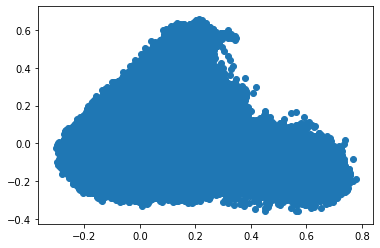

In [38]:
plt.scatter(pca_descriptors[:, 0], pca_descriptors[:, 1])

In [39]:
max_c = np.max(pca_descriptors)
min_c = np.min(pca_descriptors)
colors = np.clip((pca_descriptors - min_c) / (max_c - min_c), 0, 1)

In [40]:
mask = np.linalg.norm(final_keypoints[:, :3], axis=1) < 30
show_points = final_keypoints[mask]
show_colors = colors[mask]
fig = go.Figure(data=[go.Scatter3d(x=show_points[:, 0], y=show_points[:, 1], z=show_points[:, 2],
                                   mode='markers',
                                       marker=dict(
        size=1,
        color=show_colors,                # set color to an array/list of desired values

    )
                                  )])
fig.show()

In [41]:
data = {"keypoints": final_keypoints,
        "descriptors": final_descriptors}
np.save("../fire_keypoints.np", data)

In [52]:
from sklearn.linear_model import LinearRegression, Ridge, BayesianRidge
from sklearn.model_selection import train_test_split

In [53]:
def test_regression(x, keypoints, regression_class, test_size):
    point_x, point_y, point_z = keypoints.T
    train_x, test_x, train_y, test_y = train_test_split(x, point_x, test_size=test_size, random_state=42)
    model = regression_class().fit(train_x, train_y)
    print("x score = {}".format(model.score(test_x, test_y)))
    train_x, test_x, train_y, test_y = train_test_split(x, point_y, test_size=test_size, random_state=42)
    model = regression_class().fit(train_x, train_y)
    print("y score = {}".format(model.score(test_x, test_y)))
    train_x, test_x, train_y, test_y = train_test_split(x, point_z, test_size=test_size, random_state=42)
    model = regression_class().fit(train_x, train_y)
    print("z score = {}".format(model.score(test_x, test_y)))

In [49]:
test_regression(final_descriptors, final_keypoints, LinearRegression, 0.33)

x score 0.6901872420240298
y score 0.6579618967012418
z score 0.3553939547087579


In [50]:
test_regression(final_descriptors, final_keypoints, Ridge, 0.33)

x score 0.6901258596686314
y score 0.6578902303473104
z score 0.35550289011325725


In [54]:
test_regression(final_descriptors, final_keypoints, BayesianRidge, 0.33)

x score 0.6902652246349728
y score 0.6580131785515368
z score 0.3554840604498869
